In [1]:
import pickle
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from scipy.spatial import cKDTree
import math
from numpy.fft import fft2, fftshift
from scipy.ndimage import gaussian_filter
from mpl_toolkits.mplot3d import Axes3D         
from matplotlib.gridspec import GridSpec
from scipy.spatial import Delaunay
from scipy.stats import gaussian_kde
from scipy.signal import find_peaks
from numpy.random import default_rng


In [2]:
from functions.old import finding_defects_02 as df
from functions.old import three_d as dimension

In [ ]:
percentages = ["5", "9_1", "12_5"]
loaded_data = {}

for perc in percentages:
    fn = f"/Users/gguinan/Library/CloudStorage/OneDrive-NREL/spring2025code/for_github2/data/{perc}_percent_stats_20250623.pkl"
    with open(fn, "rb") as f:
        loaded_data[perc] = pickle.load(f)     # store *all* keys for that percent

In [4]:
df_all = dimension.load_df("../3_three_dimensional/try3_filtered_data")
df_all

,percent,sample_id,group,label,vac_size,category,cluster_uid,x,y,flat_cat
0,5,0,2,atom,NaN,atom,5_0_-1,259.523,6.098,['atom']
1,5,0,3,atom,NaN,atom,5_0_-1,272.182,5.855,['atom']
2,5,0,1,atom,NaN,atom,5_0_-1,284.841,5.612,['atom']
3,5,0,2,atom,NaN,atom,5_0_-1,297.501,5.369,['atom']
4,5,0,3,atom,NaN,atom,5_0_-1,310.160,5.126,['atom']
...,...,...,...,...,...,...,...,...,...,...
155115,12_5,25,2,defect,1.0,isolated vacancy,12_5_25_44,456.465,407.179,['isolated vacancy']
155116,12_5,25,3,defect,2.0,sandwich,12_5_25_45,21.790,417.100,['sandwich']
155117,12_5,25,2,defect,2.0,sandwich,12_5_25_45,9.899,417.650,['sandwich']
155118,12_5,25,2,defect,2.0,complex,12_5_25_38,407.693,480.821,['complex']


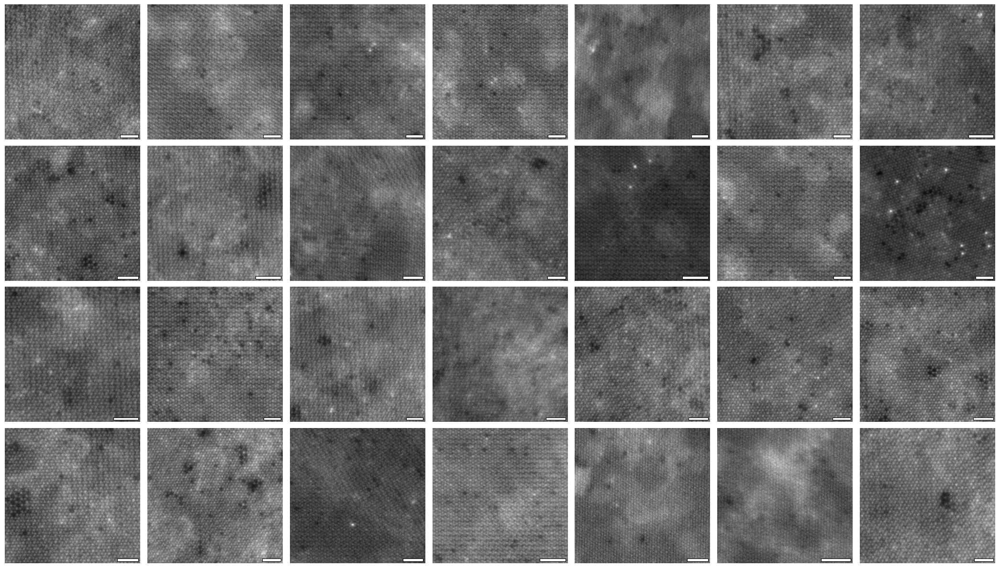

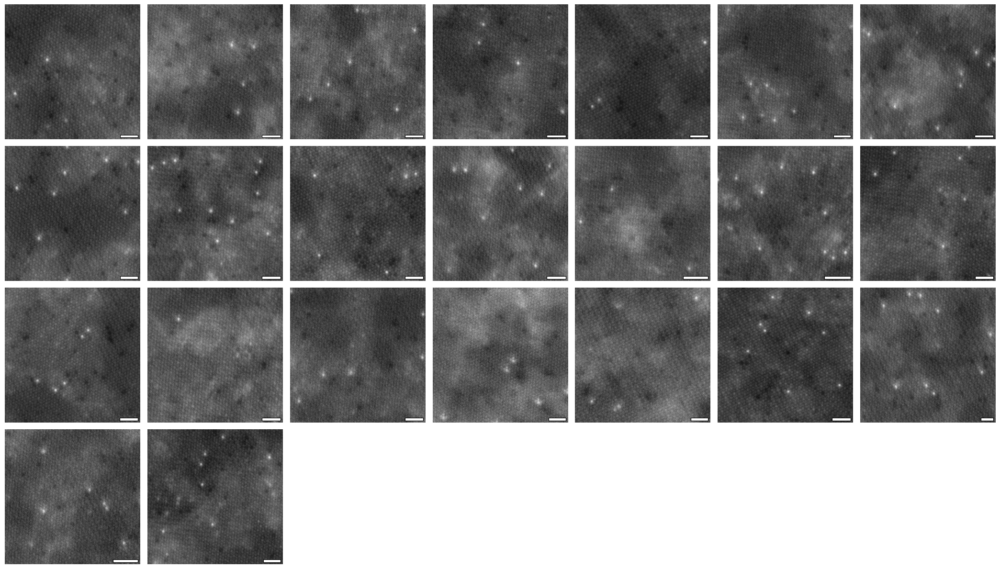

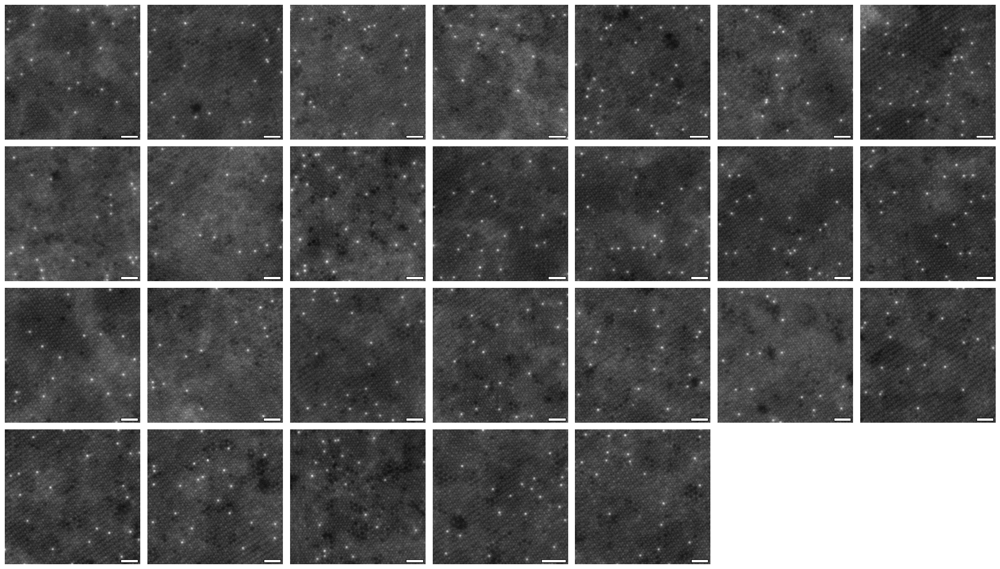

In [5]:
# Plot masks/images for each percent group, using only indices present in df_all
# Set this once: True -> use s['mask']; False -> use s['image']
use_mask = False
bar_nm   = 1.0

for p in ['5', '9_1', '12_5']:
    valid_ids = (df_all.loc[df_all['percent'].astype(str) == p, 'sample_id']
                        .dropna().astype(int).unique())
    valid_ids.sort()

    images_new    = []
    pixel_sizes   = []
    overlay_meta  = []

    stats_list = loaded_data[p]['img_stats']
    for idx in valid_ids:
        if 0 <= idx < len(stats_list):
            s = stats_list[idx]
            img = df.image_preprocess(s['mask'] if use_mask else s['image'])
            images_new.append(img)
            pixel_sizes.append(float(s['pixel_size_nm']))
            overlay_meta.append({'percent': p, 'sample_id': int(idx)})

    if not images_new:
        continue  # nothing to plot for this percent

    df.plot_grid(
        images_new,
        cols=7,
        title_prefix=None,                       # no per-image titles
        pixel_sizes_nm_per_px=pixel_sizes,
        scale_bar_nm=bar_nm,
        show_scale_label=False,
        scale_bar_height_px=10,
        overlay_df=None,                         # set to your tidy df if you want point overlays
        overlay_meta=overlay_meta                # keep alignment if you later pass overlay_df
    )


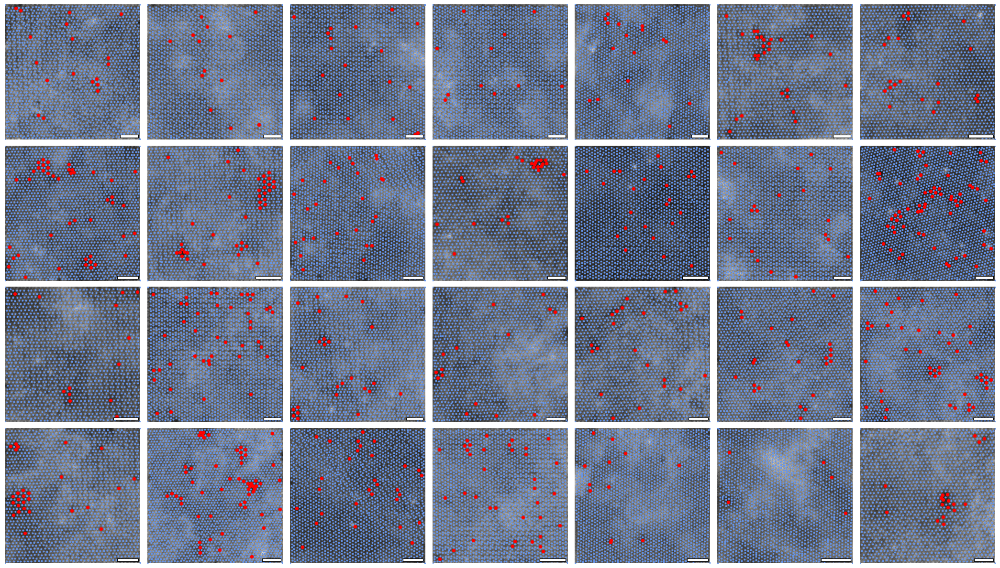

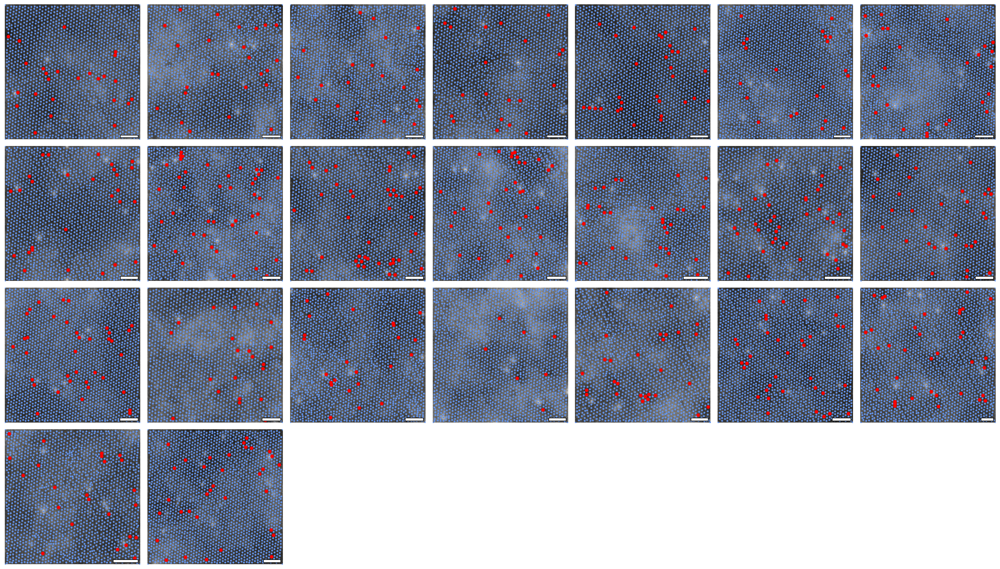

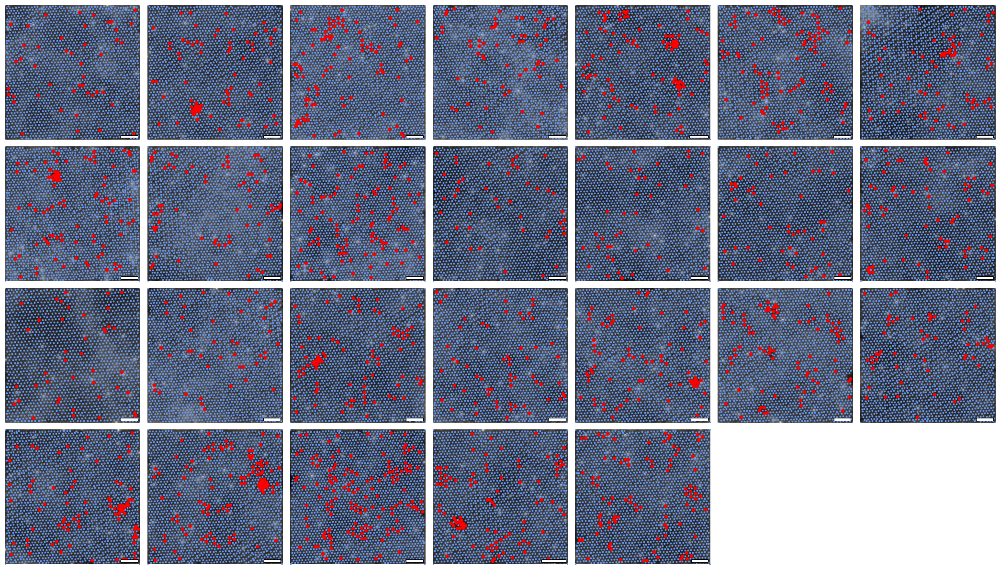

In [6]:
# Plot images + overlays for each percent group, using only indices present in df_all
bar_nm = 1.0

for p in ['5', '9_1', '12_5']:
    valid_ids = (df_all.loc[df_all['percent'].astype(str) == p, 'sample_id']
                        .dropna().astype(int).unique())
    valid_ids.sort()

    images_new   = []
    pixel_sizes  = []
    atoms_list   = []
    defect_list  = []

    stats_list = loaded_data[p]['img_stats']
    for idx in valid_ids:
        if 0 <= idx < len(stats_list):
            s = stats_list[idx]
            img = df.image_preprocess(s['image'])
            images_new.append(img)
            pixel_sizes.append(float(s['pixel_size_nm']))
            atoms_list.append(s.get('regular_points', []))
            defect_list.append(s.get('defect_points', []))

    if not images_new:
        continue

    df.plot_grid(
        images_new,
        cols=7,
        title_prefix=None,
        pixel_sizes_nm_per_px=pixel_sizes,
        scale_bar_nm=bar_nm,
        show_scale_label=False,
        scale_bar_height_px=10,
        overlay_atoms=atoms_list,
        overlay_defects=defect_list,
        atom_size=8,
        defect_size=28,
        atom_color="cornflowerblue",
        defect_color="red"
    )


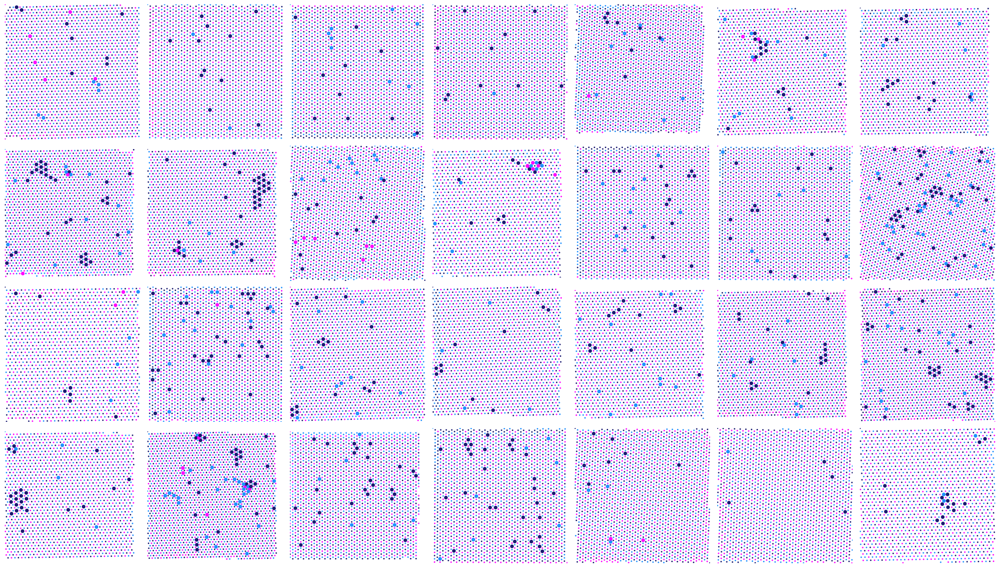

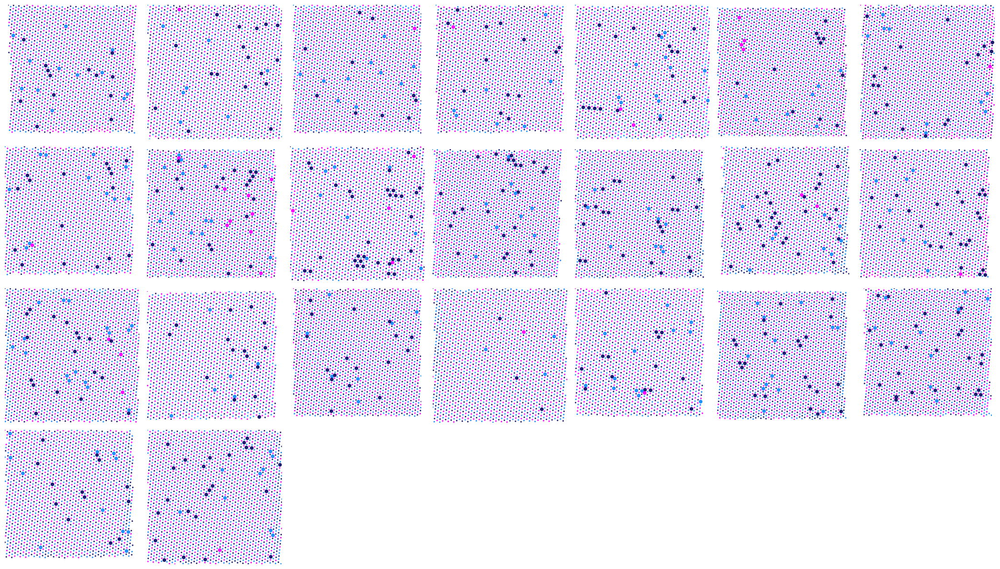

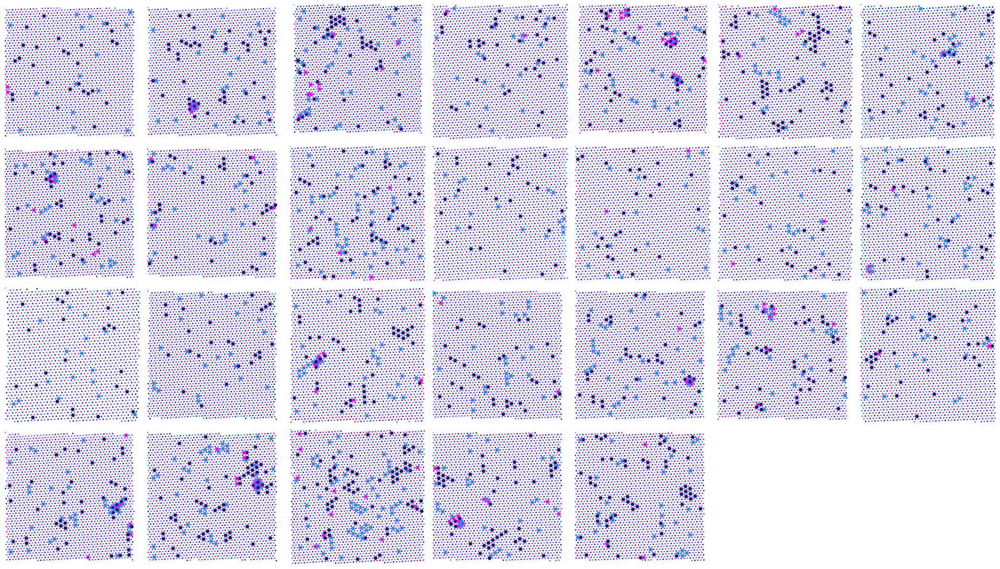

In [7]:
# White backgrounds (true white) + df_all points:
# - make RGB white canvases matching each original image size
# - color by group (fuchsia, dodgerblue, midnightblue)
# - defect points larger than atom points

bar_nm = 1.0
group_colors = {1: 'fuchsia', 2: 'dodgerblue', 3: 'midnightblue'}

for p in ['5', '9_1', '12_5']:
    valid_ids = (df_all.loc[df_all['percent'].astype(str) == p, 'sample_id']
                        .dropna().astype(int).unique())
    valid_ids.sort()

    images_new, pixel_sizes, overlay_meta = [], [], []
    stats_list = loaded_data[p]['img_stats']

    for idx in valid_ids:
        if 0 <= idx < len(stats_list):
            s = stats_list[idx]
            base = s['image']
            base = np.asarray(base)  # handle PIL or array
            h, w = 512,512
            white_rgb = np.full((h, w, 3), 255, dtype=np.uint8)  # avoids grayscale normalization -> stays white
            images_new.append(white_rgb)
            pixel_sizes.append(float(s['pixel_size_nm']))
            overlay_meta.append({'percent': p, 'sample_id': int(idx)})

    if not images_new:
        continue

    df.plot_grid(
        images_new,
        cols=7,
        title_prefix=None,
        overlay_df=df_all,          # uses percent, sample_id, group, label, x, y
        overlay_meta=overlay_meta,
        group_colors=group_colors,
        atom_size=5,
        defect_size=30
    )


In [8]:
loaded_data['5'].keys()

dict_keys(['img_stats', 'total_vac', 'total_points', 'percent_vacancies'])

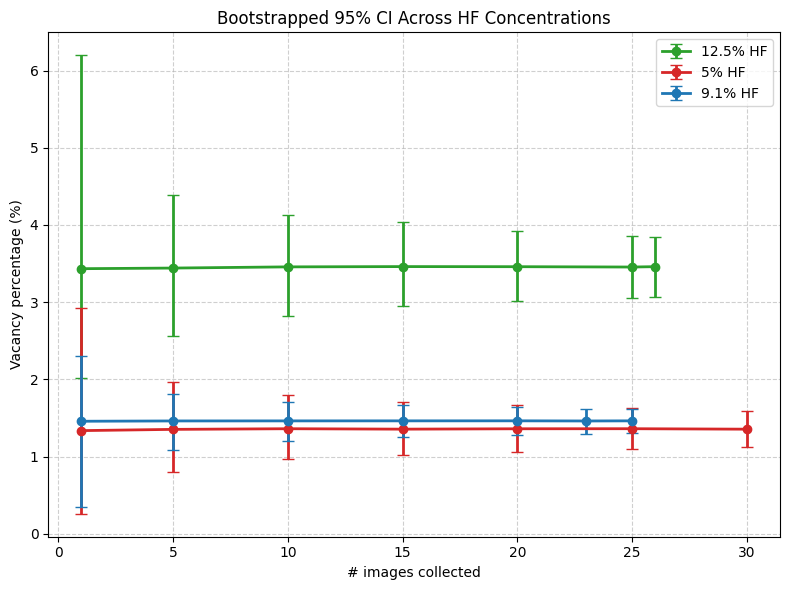

In [9]:
results = df.bootstrapping_plot(loaded_data)

In [10]:
df.make_sample_csvs(loaded_data, out_dir="stats")

In [11]:
s['defect_points']

array([[359.        , 116.        ],
       [209.        , 256.        ],
       [ 95.5       , 323.        ],
       [162.        , 331.        ],
       [ 92.5       , 354.        ],
       [127.        , 443.        ],
       [105.        , 262.5       ],
       [339.        , 361.        ],
       [ 48.5       , 489.        ],
       [171.        , 493.        ],
       [418.        , 225.        ],
       [128.5       , 281.        ],
       [447.        , 304.        ],
       [313.        , 414.        ],
       [112.        , 109.        ],
       [139.5       , 260.        ],
       [422.66666667, 285.33333333],
       [494.5       , 302.5       ],
       [134.        , 453.        ],
       [463.5       ,  18.        ],
       [358.6       ,  24.2       ],
       [ 38.66666667,  31.66666667],
       [353.        ,  34.        ],
       [148.5       ,  35.5       ],
       [278.5       ,  48.5       ],
       [445.        , 102.        ],
       [172.5       , 125.5       ],
 

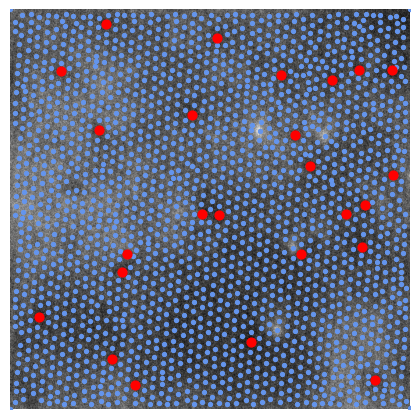

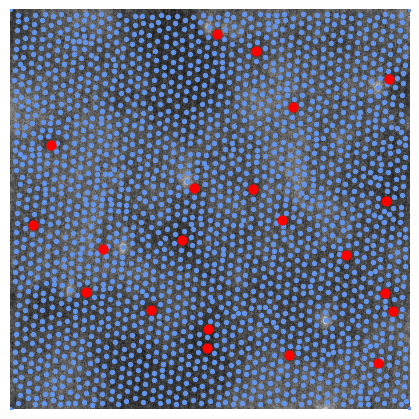

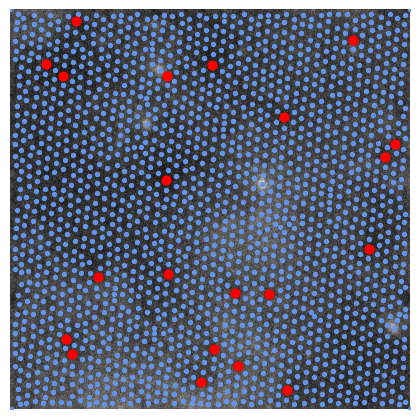

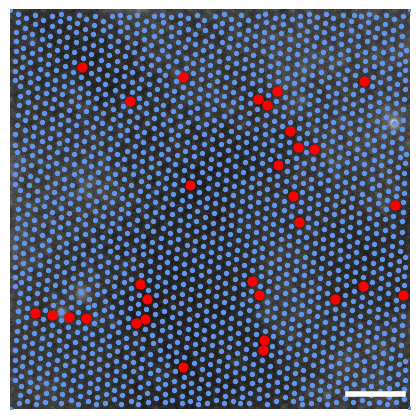

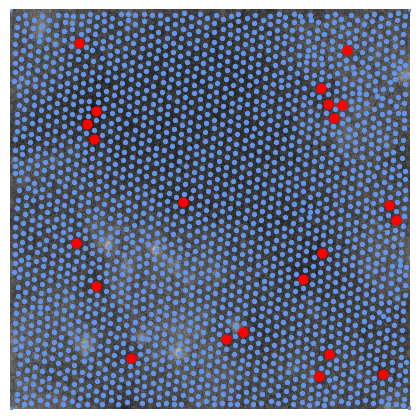

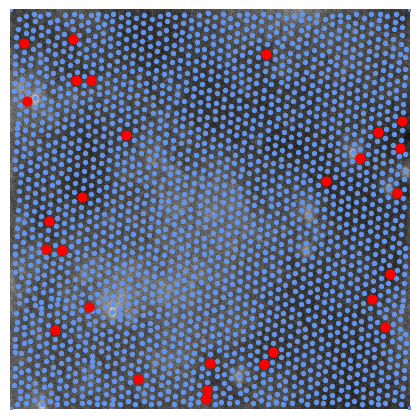

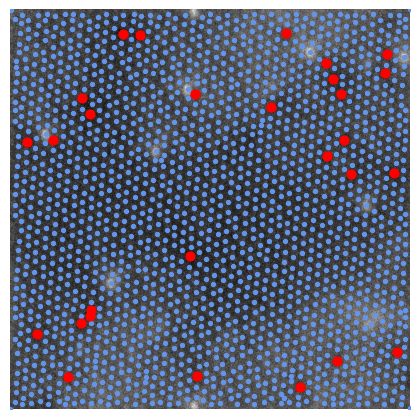

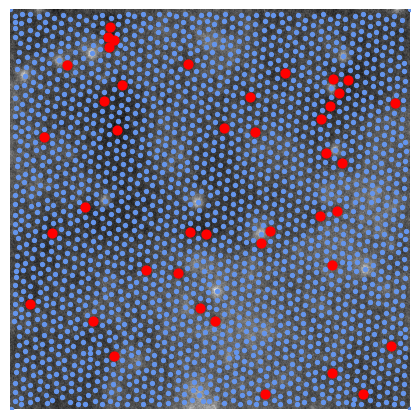

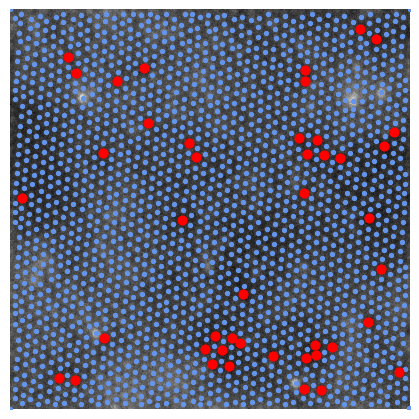

In [20]:
bar_nm = 1
for i in range(1, 10):
    s = loaded_data['9_1']['img_stats'][i]
    img    = df.image_preprocess(s['image'])
    px_nm  = s['pixel_size_nm']
    bar_px = int(bar_nm / px_nm)      
    fig  = plt.figure(figsize=(4, 4), dpi=100, facecolor='none')
    fig.patch.set_alpha(0)                # transparent figure background
    ax   = fig.add_axes([0, 0, 1, 1], facecolor='none')
    xy = s['defect_points']
    xy_atoms = s['regular_points']
    ax.scatter(xy_atoms[:, 0], xy_atoms[:, 1], s=8, c='cornflowerblue', marker='o', label='defect points')

    ax.scatter(xy[:, 0], xy[:, 1], s=40, c='red', marker='o', label='defect points')

    ax.imshow(img, cmap='gray')
    h, w = img.shape[:2]

    # draw scale-bar (bottom-right)
    if i ==4:
        ax.plot([w - bar_px - 10, w - 10], [h -20, h - 20], 'white', lw=4)
        ax.text(w - bar_px +50, h - 30, "", color='white', fontsize=12, ha='right')
    plt.axis('off')
    plt.show()


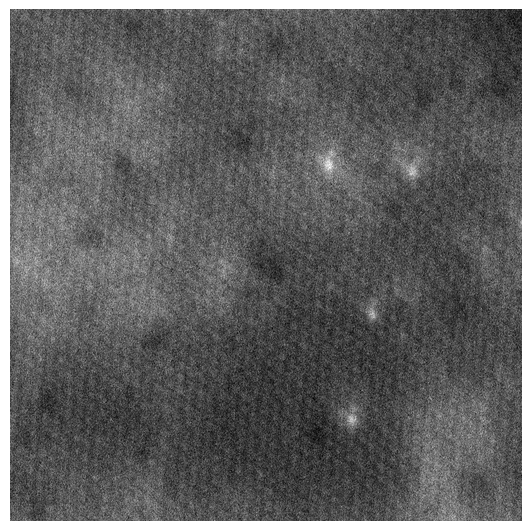

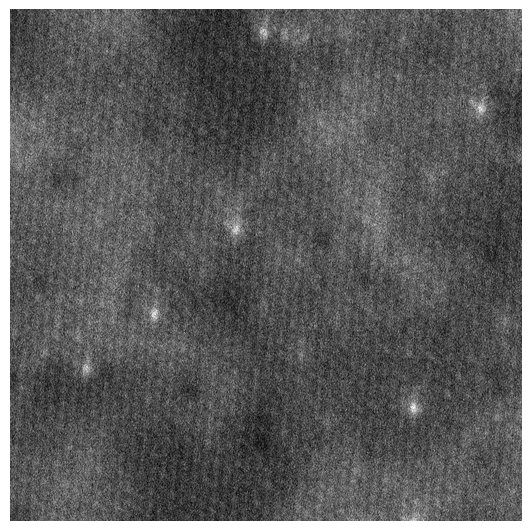

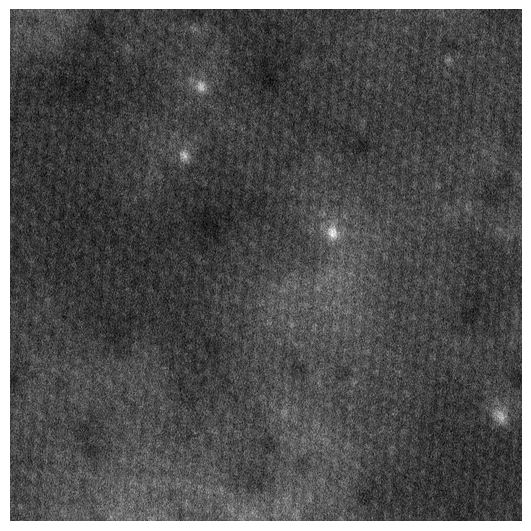

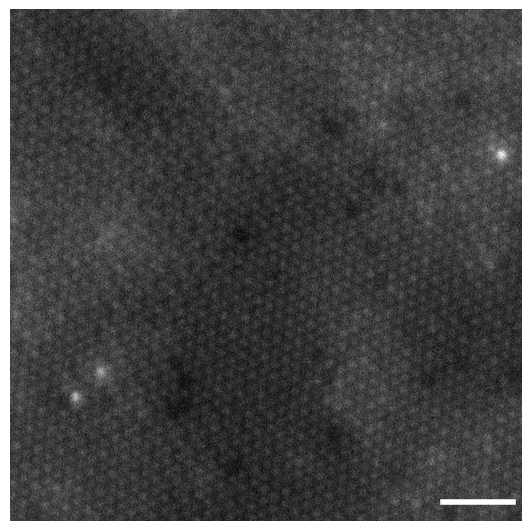

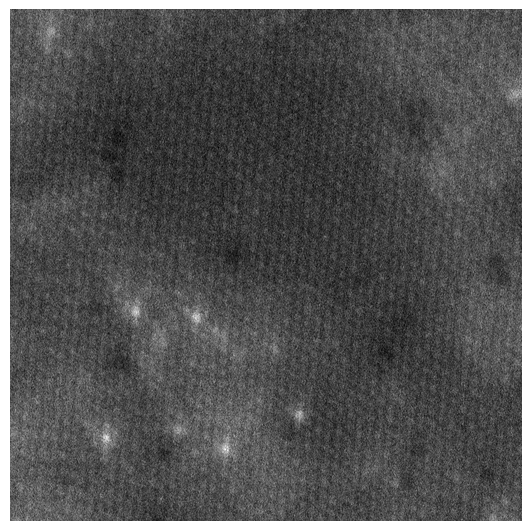

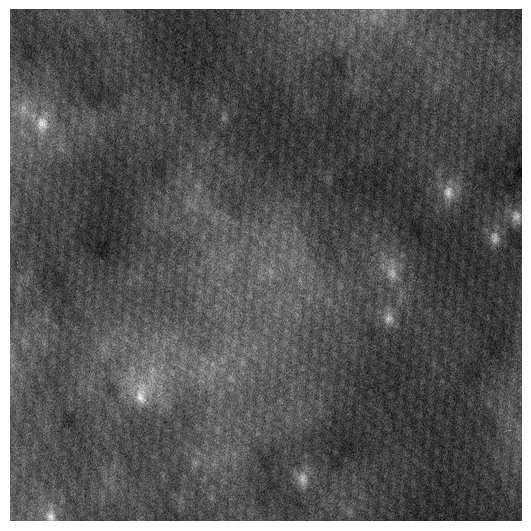

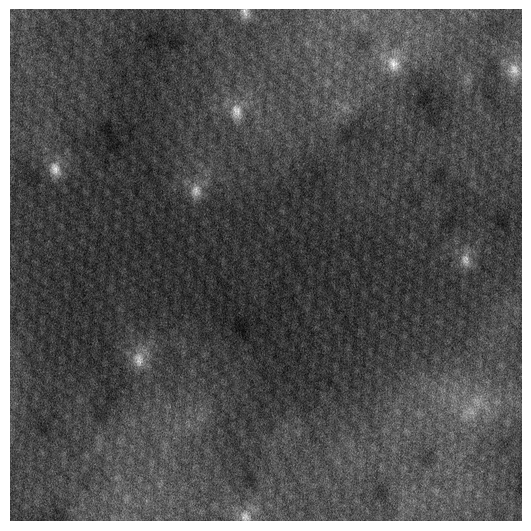

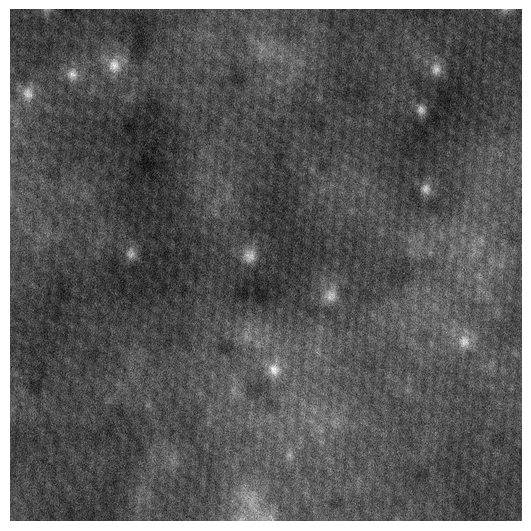

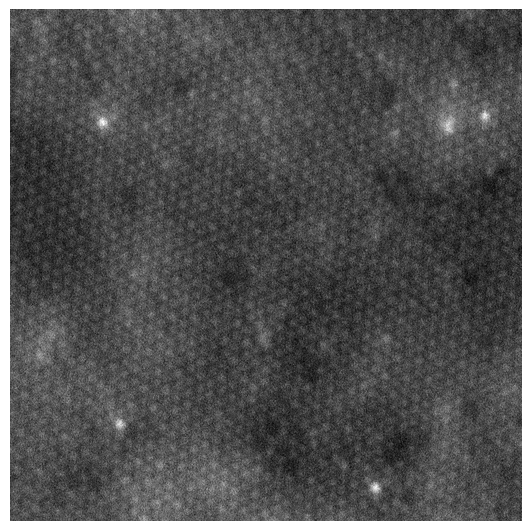

In [19]:
bar_nm = 1
for i in range(1, 10):
    s = loaded_data['9_1']['img_stats'][i]
    img    = df.image_preprocess(s['image'])
    px_nm  = s['pixel_size_nm']
    bar_px = int(bar_nm / px_nm)      
    fig  = plt.figure(figsize=(w/100, h/100), dpi=100, facecolor='none')
    fig.patch.set_alpha(0)                # transparent figure background
    ax   = fig.add_axes([0, 0, 1, 1], facecolor='none')
    ax.imshow(img, cmap='gray')
    h, w = img.shape[:2]

    # draw scale-bar (bottom-right)
    if i ==4:
        ax.plot([w - bar_px - 10, w - 10], [h -20, h - 20], 'white', lw=4)
        ax.text(w - bar_px +50, h - 30, "", color='white', fontsize=12, ha='right')
    plt.axis('off')
    plt.show()

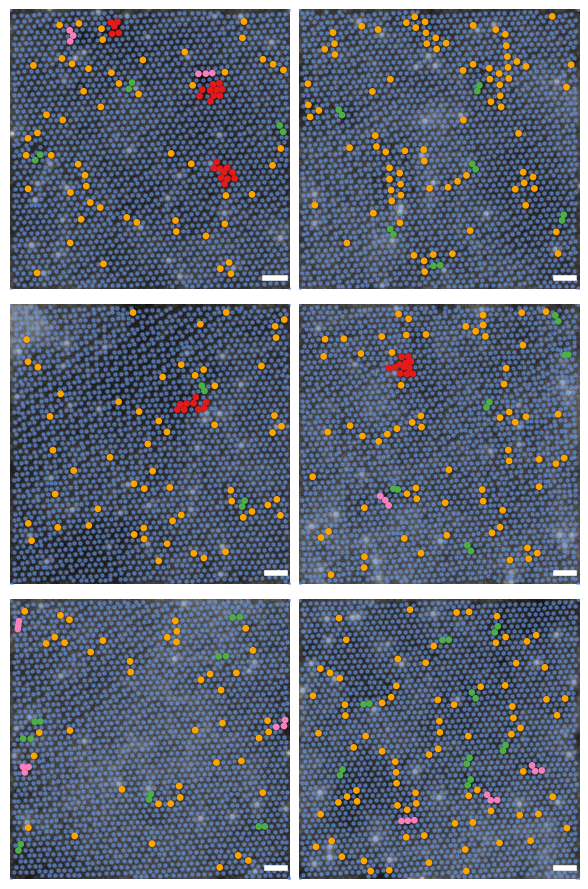

In [8]:

def plot_img_grid_with_scalebars(stats, bar_nm=2, rows = None):
    n = len(stats)
    if rows is None:
        cols = math.ceil(n**0.5)
        rows = math.ceil(n / cols)
    else:
        cols = math.ceil(n / rows)
    fig, axs = plt.subplots(rows, cols, figsize=(cols * 3, rows * 3))
    for ax, s in zip(axs.ravel(), stats):
        img    = df.image_preprocess(s['image'])
        px_nm  = s['pixel_size_nm']
        bar_px = int(bar_nm / px_nm)        # length of scale-bar in pixels

        ax.imshow(img, cmap='gray')
        h, w = img.shape[:2]

        # draw scale-bar (bottom-right)
        ax.plot([w - bar_px - 10, w - 10], [h -20, h - 20], 'white', lw=4)
        ax.scatter(s['regular_points'][:, 0], s['regular_points'][:, 1], s = 5, c= 'cornflowerblue', label='Regular Atoms', alpha = .5)        
        ax.scatter(s['defect_points'][:, 0], s['defect_points'][:, 1], s = 15, c= s['colors'], label='Regular Atoms')        

        ax.axis('off')

    for ax in axs.ravel()[len(stats):]:
        ax.axis('off')
    plt.tight_layout()


# usage
plot_img_grid_with_scalebars(loaded_data['12_5']['img_stats'][4:10], bar_nm=.5, rows = 3)


In [9]:
img_stats5 = loaded_data['5']['img_stats']
img_stats9 = loaded_data['9_1']['img_stats']
img_stats12 = loaded_data['12_5']['img_stats']

In [10]:
colors = np.concatenate([stat['colors'] for stat in img_stats12], axis=0)
total_vac = len(colors)
total_points = sum(len(stat['regular_points']) for stat in img_stats12)

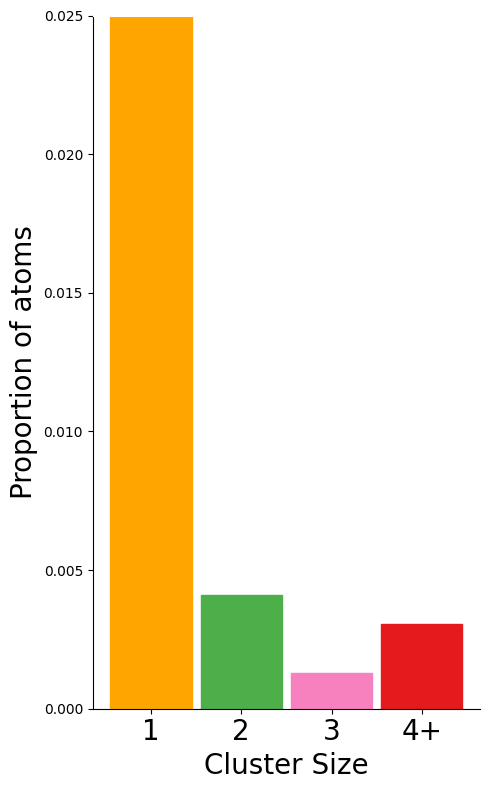

In [11]:
fig, ax2 = plt.subplots(figsize=(5, 8))
#ax2.set_facecolor('none')  # Make axes background transparent

color_order = ['orange', '#4daf4a', '#f781bf', '#e41a1c']
fractions = [(colors == col).sum() / (total_points + total_vac) for col in color_order]


for i, (col, frac) in enumerate(zip(color_order, fractions), 1):
    ax2.bar(i, frac, color=col, edgecolor=col, width=0.9)


ax2.set_xticks(range(1, 5))

ax2.set_xticklabels(['1', '2', '3', '4+'], c="black", size = 20)
ax2.set_xlabel("Cluster Size", fontsize=20, c="black")
ax2.set_ylabel("Proportion of atoms",  c="black", fontsize = 20)
ax2.tick_params(colors='black')
ax2.spines['top'].set_color('white')
ax2.spines['right'].set_color('white')
ax2.set_ylim(0, 0.025)
plt.tight_layout()
#plt.legend(['1', '2', '3', '4+'], loc='upper right', fontsize=10, frameon=False, title = "Number of atoms in vacancy", title_fontsize=15, ncol=4)
plt.show()


In [12]:
def vacancy_percent(sample):
    vac = sum(len(s['defect_points']) for s in sample)
    reg = sum(len(s['regular_points']) for s in sample)
    return 100 * vac / (vac + reg)

sample_sizes = [1, 5, 10, 15, 20, 25]

# Store all result DataFrames
results_all = []

for label, data in loaded_data.items():
    image_stats = data["img_stats"]
    N_imgs = len(image_stats)
    sample_sizes_full = sample_sizes + [N_imgs]
    B = 4000
    rng = default_rng(42)

    records = []
    for n in sample_sizes_full:
        boots = [
            vacancy_percent([image_stats[i] for i in rng.choice(N_imgs, size=n, replace=True)])
            for _ in range(B)
        ]
        boots = np.asarray(boots)
        records.append({
            'size': n,
            'mean': boots.mean(),
            'se': boots.std(ddof=1),
            'ci_lower': np.percentile(boots, 2.5),
            'ci_upper': np.percentile(boots, 97.5),
        })

    results = pd.DataFrame(records).sort_values('size')
    se_full = results.loc[results['size'] == N_imgs, 'se'].iloc[0]
    results['rel_se'] = results['se'] / se_full
    results['ci_minus'] = results['mean'] - results['ci_lower']
    results['ci_plus'] = results['ci_upper'] - results['mean']
    results['label'] = label.replace('_', '.')

    results_all.append(results)


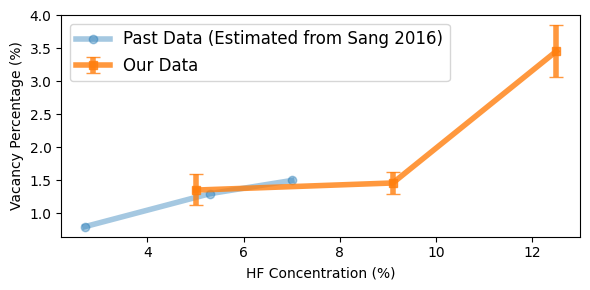

In [16]:
# Past data (no error bars)
past_data = [(2.7, 0.8), (5.3, 1.3), (7.0, 1.5)]
past_x, past_y = zip(*past_data)

# Our data (with error bars)
our_x, our_y, yerr_lower, yerr_upper = [], [], [], []
for df in results_all:
    full = df[df["size"] == df["size"].max()].iloc[0]   # row for N_imgs
    our_x.append(float(full["label"]))                  # HF %
    our_y.append(full["mean"])
    yerr_lower.append(full["ci_minus"])
    yerr_upper.append(full["ci_plus"])


plt.figure(figsize=(6, 3))

# Plot past data
plt.plot(past_x, past_y, marker='o', label='Past Data (Estimated from Sang 2016)', color='tab:blue', linewidth=4, alpha = .4)

# Plot our data with error bars
plt.errorbar(
    our_x, our_y,
    yerr=[yerr_lower, yerr_upper],
    marker='s', label='Our Data',
    color='tab:orange', capsize=5, linewidth=4, alpha = .8

)

# Add per-image data points
"""for hf in our_x:
    key = next(k for k in loaded_data if abs(float(k.replace('_', '.')) - hf) < 0.01)
    image_stats = loaded_data[key]['image_stats']

    per_image = [
        100 * len(stat['defect_points']) / (len(stat['defect_points']) + len(stat['regular_points']))
        if (len(stat['defect_points']) + len(stat['regular_points'])) > 0 else 0
        for stat in image_stats
    ]

    x_vals = [hf] * len(per_image)
    plt.scatter(x_vals, per_image, color='tab:orange', alpha=0.3, s=20, label='_nolegend_')
"""
plt.xlabel("HF Concentration (%)", fontsize=10)
plt.ylabel("Vacancy Percentage (%)", fontsize=10)
plt.legend(fontsize = 12)
plt.tight_layout()
plt.tick_params()
plt.show()


In [32]:
import pickle, numpy as np
from pathlib import Path
from scipy.spatial import cKDTree
percentages = ["5", "9_1", "12_5"]

# ── load the three .pkl files -------------------------------------------------
pkl_dir      = Path("data")
loaded_data = {}

for perc in percentages:
    fn = f"/Users/gguinan/Library/CloudStorage/OneDrive-NREL/spring2025code/for_github2/data/{perc}_percent_stats_20250623.pkl"
    with open(fn, "rb") as f:
        loaded_data[perc] = pickle.load(f)     # store *all* keys for that percent


all_sep_pm, iqr_stats = {}, {}
for perc, data in loaded_data.items():

    stats       = data["img_stats"]
    px_nm_arr   = data.get("pixel_sizes_nm", [])
    seps        = []

    for idx, stat in enumerate(stats):
        reg_pts     = stat["regular_points"]
        dists = cKDTree(reg_pts).query(reg_pts, k=7)[0][:, 1:]  
        base = np.median(dists)

        dft_pts     = stat["defect_points"]
        d_px  = cKDTree(dft_pts).query(dft_pts, k=2)[0][:, 1]      
        seps.extend(d_px / base)

    seps = np.asarray(seps)
    all_sep_pm[perc] = seps

    q1, med, q3 = np.percentile(seps, [25, 50, 75])
    whisk_hi    = seps[seps <= q3 + 1.5 * (q3 - q1)].max()
    iqr_stats[perc] = (q1, med, q3, whisk_hi)


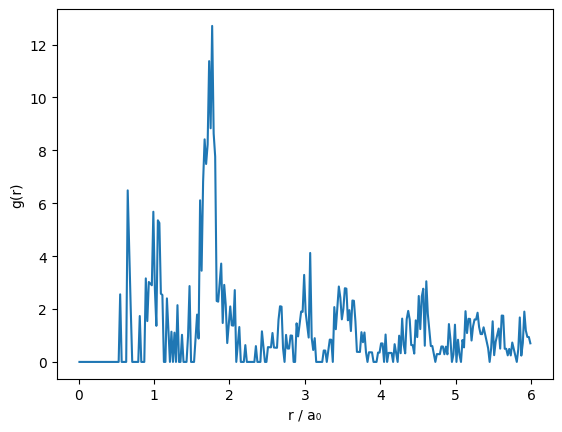

In [33]:
from scipy.spatial import distance
# --- parameters you might tweak ---------------------------------------------
bin_w      = 0.02          # Δr, in units of the lattice constant a₀
r_max_mult = 6             # up to 6 a₀ is usually enough for hex lattices
# -----------------------------------------------------------------------------

all_rdf = {}                                # {perc: (r_centres, g_r)}

for perc, data in loaded_data.items():
    stats       = data["img_stats"]

    # accumulate histogram, total point-count and FOV-area (all in a₀ units)
    bins        = np.arange(0, r_max_mult + bin_w, bin_w)
    hist        = np.zeros(bins.size - 1)
    N_tot       = 0.0
    A_tot       = 0.0

    for stat in stats:
        pts     = np.asarray(stat["regular_points"], float)
        df_pts  = np.asarray(stat["defect_points"],  float)

        # lattice constant a₀ (median NN among regular atoms)
        a0 = np.median(cKDTree(pts).query(pts, k=7)[0][:, 1:])

        # FOV area in a₀²
        A_tot += pts.ptp(0).prod() / a0**2

        # defect–defect pairs
        if df_pts.shape[0] >= 2:
            r_ij  = distance.pdist(df_pts) / a0
            hist += np.histogram(r_ij, bins=bins)[0]

        # total number of defects
        N_tot += df_pts.shape[0]
        A_tot     += pts.ptp(0).prod() / a0**2     # FOV area in a₀²

    # normalise → g(r)   (2-D:  g(r) = counts / [ρ·2πrΔr·N])
    ρ      = N_tot / A_tot
    r_mid  = 0.5 * (bins[1:] + bins[:-1])
    Δr     = np.diff(bins)
    g_r    = hist / (ρ * 2 * np.pi * r_mid * Δr * N_tot)

    all_rdf[perc] = (r_mid, g_r)

# ── quick check / plot ───────────────────────────────────────────────────────
r, g = all_rdf['9_1']
plt.plot(r, g); plt.xlabel('r / a₀'); plt.ylabel('g(r)'); plt.show()


Text(0.59, 0.5, 'Probability density')

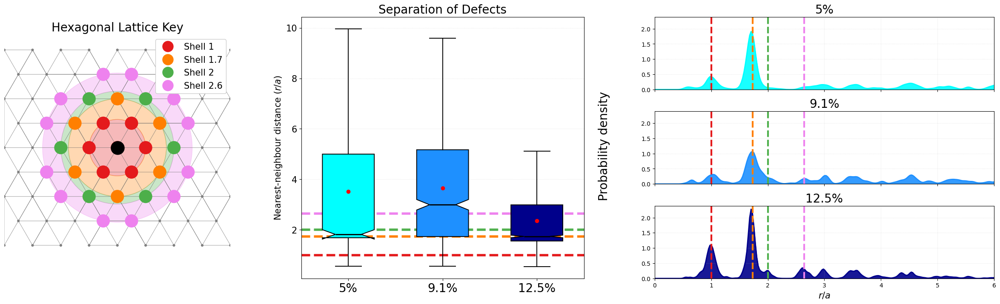

In [34]:
from matplotlib.patches import Wedge

# ===== Constants & Setup =====================================================
base = 180
layer_specs = [
    (1,              '#e41a1c',  'Shell 1'),
    (math.sqrt(3),   '#ff7f00',  'Shell 1.7'),
    (2,              '#4daf4a',  'Shell 2'), 
    (math.sqrt(7),   'violet',   'Shell 2.6'),
    (math.sqrt(7)+.1,'gray',     'other'),
]
layer_radii, layer_cols, layer_labs = zip(*layer_specs)
shell_x = [1, math.sqrt(3), 2, math.sqrt(7), 3, math.sqrt(12), math.sqrt(13), math.sqrt(16), math.sqrt(19), math.sqrt(21)]
shell_col = layer_cols[:5]
sample_colors = ["cyan", "dodgerblue", "darkblue"]

# ===== Figure Layout =========================================================
fig = plt.figure(figsize=(30, 8))
outer = GridSpec(1, 3, width_ratios=[.8, 1, 1.2], wspace=0.25)
ax_hex = fig.add_subplot(outer[0])
ax_box = fig.add_subplot(outer[1])
gs_pdf = outer[2].subgridspec(3, 1, hspace=0.30)
ax_rdf = [fig.add_subplot(gs_pdf[i]) for i in range(3)]

# ===== 1) Boxplot ============================================================
labels_disp = [p.replace('_','.')+'%' for p in percentages]
bp = ax_box.boxplot(
    [all_sep_pm[p] for p in percentages],
    patch_artist=True,
    widths=0.55,
    notch=True,
    showfliers=False,
    tick_labels=labels_disp,
    medianprops=dict(color='black', lw=2),
    whiskerprops=dict(lw=1.4),
    capprops=dict(lw=1.4)
)

for i, box in enumerate(bp['boxes']):
    box.set(facecolor=sample_colors[i], linewidth=1.4)

for i, perc in enumerate(percentages, 1):
    ax_box.plot(i, np.mean(all_sep_pm[perc]), 'o', color='red', ms=6, label='Mean' if i==1 else "")

for r, col, _ in layer_specs[:4]:
    ax_box.axhline(r, color=col, ls='--', lw=4, zorder=0)

ax_box.set_title("Separation of Defects", fontsize = 20)
ax_box.set_ylabel(r"Nearest-neighbour distance ($r / a$)", fontsize = 15)
ax_box.grid(axis='y', ls=':', alpha=.35)
ax_box.tick_params(axis='x', labelsize=20)
ax_box.tick_params(axis='y', labelsize=15)


# ===== 2) Hexagonal Lattice Plot =============================================
L_pm, a_pm = 4, 1
sqrt3 = math.sqrt(3)

pts = []
nmax = int(L_pm // a_pm) + 3
for i in range(-nmax, nmax+1):
    for j in range(-nmax, nmax+1):
        x = i*a_pm + j*a_pm/2
        y = j*a_pm*sqrt3/2
        if abs(x) <= L_pm and abs(y) <= L_pm:
            pts.append((x, y))
pts = np.asarray(pts)
tri = Delaunay(pts)

radii = np.linalg.norm(pts, axis=1)
idx_layer = np.abs(radii[:, None] - np.array(layer_radii)).argmin(1)
dot_cols = [layer_cols[i] for i in idx_layer]
sizes = np.where(idx_layer < 4, 500, 20)

ax_hex.set(aspect='equal', xlim=(-L_pm, L_pm), ylim=(-L_pm, L_pm))
ax_hex.axis('off')
ax_hex.set_title("Hexagonal Lattice Key", fontsize=20)
ax_hex.scatter(pts[:,0], pts[:,1], s=sizes, c=dot_cols, edgecolors='none', zorder=2)
ax_hex.scatter(0, 0, c="black", s=500, zorder=3)
for s in tri.simplices:
    ax_hex.plot(pts[s,0], pts[s,1], color='#666', lw=.6, alpha=.75, zorder=1)

for r, col, lab in layer_specs[:4]:
    ax_hex.plot([], [], marker='o', ms=6, ls='', color=col, label=lab)

radii = [r for r, *_ in layer_specs[:4]]
for i in range(len(radii)):
    inner = 0 if i == 0 else radii[i-1]
    outer = radii[i]
    color = layer_cols[i]
    ring = Wedge(center=(0, 0), r=outer, theta1=0, theta2=360,
                 width=outer - inner, color=color, alpha=0.3, zorder=0)
    ax_hex.add_patch(ring)

ax_hex.legend(loc='upper right', fontsize=15, framealpha=1, markerscale=3)

# ===== 3) RDF Plots ==========================================================
x_grid = np.linspace(0, 10, 400)
y_max = 0
curves = []
for perc, col in zip(percentages, sample_colors):
    vals = all_sep_pm[perc]
    kde = gaussian_kde(vals, bw_method=0.02)
    y = kde(x_grid)
    curves.append((perc, col, y))
    y_max = max(y_max, y.max())

for ax, (perc, col, y) in zip(ax_rdf, curves):
    ax.plot(x_grid, y, lw=2, color=col)
    ax.fill_between(x_grid, y, color=col, alpha=0.9)
    for x, c in zip(shell_x[:4], shell_col):
        ax.axvline(x, color=c, ls='--', lw=3)
    ax.set_xlim(0, 6)
    ax.set_ylim(0, y_max * 1.05)
    ax.grid(ls=':', alpha=.35)
    ax.set_title(perc.replace('_','.') + '%', fontsize=20)
    if ax is not ax_rdf[-1]:
        ax.set_xticklabels([])
    else:
        ax.set_xlabel(r"$r / a$", fontsize = 15)

fig.text(0.59, 0.5, "Probability density", va='center', rotation='vertical', fontsize = 20)
